In [1]:
# list_egatch = []
# i=0
# egarch_model = arch_model(returns.iloc[0+(i*50):5000+(i*50)], vol='EGARCH', p=1, o=1, q=1, dist='Normal', mean='ARX', rescale=False)
# results = egarch_model.fit(last_obs=4950, update_freq=10)
# forecasts = results.forecast(horizon=1, start=4950, method='simulation')
# list_egatch.extend(forecasts.variance[4950:]['h.1'].values)

# Блок 1. Импорт

In [3]:
import ta
import math
import numpy as np
import pandas as pd
import seaborn as sns
import datetime as dt
import matplotlib.pyplot as plt

from tqdm import tqdm
from copy import deepcopy
from matplotlib import cm
from sklearn import mixture
from matplotlib import dates
from sklearn import preprocessing
from arch.univariate import arch_model

In [4]:
sns.set()
sns.mpl.rcParams['figure.figsize'] = (25.0, 10.0)
sns.mpl.rcParams['savefig.dpi'] = 90
sns.mpl.rcParams['font.family'] = 'sans-serif'
sns.mpl.rcParams['font.size'] = 14

In [5]:
import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

import plotly.offline
import plotly.express as px

import ruptures as rpt
from hmmlearn import hmm

In [6]:
path = '/home/brainiac/Vlad/Git files/Market-Regimes/DataSets/'
file = '2019_2020_t700_OHLCV'

In [7]:
df_data = pd.read_csv(path+file+'.csv')
df_data = df_data.dropna()

In [64]:
df_data.tail(3)

,datetime,open,low,high,close,volume
408897,2020-03-19 23:57:39.508403,6190.5,6173.0,6190.5,6176.5,1061542
408898,2020-03-19 23:58:19.220855,6176.5,6175.5,6198.0,6195.5,2881013
408899,2020-03-19 23:59:59.378870,6195.5,6185.0,6198.0,6185.0,1546423


In [65]:
df_data= df_data[(df_data['datetime']<"2020-03-01")]

In [66]:
# df_data = df_data[(df_data['datetime']>="2020-02-20") & (df_data['datetime'] < "2020-03-20")] 
# df_data.index = range(len(df_data))

# Блок 2. Основыные функции

In [67]:
# Кластеризация
def clustering_GaussianHMM(df_data:pd.DataFrame,
                           n_components_:int,
                          ):
    
    model = hmm.GaussianHMM(n_components=n_components_, covariance_type="full", n_iter=100)
    model.fit(df_data)
    marked_regimes = model.predict(df_data)
    return marked_regimes

In [68]:
# Построение графиков
def show_plot_plotly(df_data:pd.DataFrame,
                     left_border,
                     right_border,
                     x_,
                     y_,
                     color_:str,
                     title_:str,             
             ):  
    fig = px.scatter(df_data[left_border:right_border], 
                 x=x_, 
                 y=y_, 
                 color=color_, 
                 #color_discrete_sequence=['blue','darkorange','green','red','gold', 'black'], 
                 title=title_
                )    
    return fig

In [69]:
# %%time
# returns = 100*df_data['close'].pct_change()

# egarch_part=10_000 # данные для модели EGARCH 
# egarch_train=9_950 # данные для обучения
# egarch_forec=50 # данные для прогноза
# egarch_vol = [] # список для волатильности
# egarch_vol.extend(abs(df_data['close'][0:egarch_train+1].pct_change().rolling(5).std()*100)) # первые несколько измерений заменяются простым std

# for i in range(1, math.ceil((len(df_data)-egarch_train)/egarch_forec)+1):
#     egarch_model = arch_model(returns.iloc[(i-1)*egarch_forec:egarch_part+egarch_forec*(i-1)].dropna(), vol='EGARCH', p=1, o=1, q=1, dist='studentst', mean='ARX', rescale=False)
#     results = egarch_model.fit(last_obs=egarch_part-egarch_forec, update_freq=10) # обучение модели
#     forecasts = results.forecast(horizon=1, start=egarch_part-egarch_forec, method='simulation') # прогнозирование волатильности
#     egarch_vol.extend(np.sqrt(forecasts.variance.dropna()['h.1'].values)) # формирование списка волатильностей

In [70]:
def getting_balances(df_data: pd.DataFrame):
    market = df_data['close']
    returns = 100 * market.pct_change().dropna()
    return returns

In [71]:
returns = getting_balances(df_data)

In [72]:
returns.head()

1   -0.149031
2    0.067843
3    0.013559
4    0.162690
5    0.081213
Name: close, dtype: float64

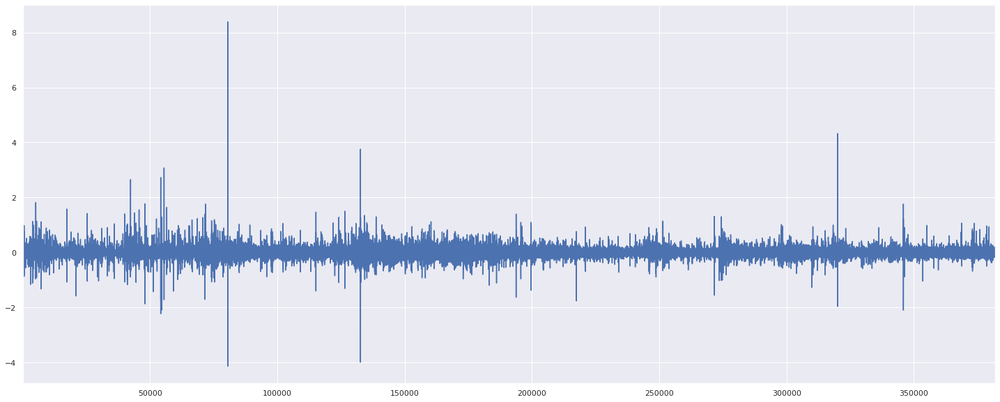

In [73]:
returns.plot()

In [74]:
df_data.shape

(381908, 6)

In [8]:
(len(df_data )-10_000)/500

797.8

In [9]:
math.ceil((len(df_data )-10_000)/500)

798

In [76]:
list_egatch_variance_10K = []
list_egatch_residual_10K = []
# vol_std = df_data['close'][0:5000].pct_change().rolling(5).std()
# list_egatch_variance.extend(vol_std)
# list_egatch_residual.extend(vol_std)
for i in tqdm(range(744)):
    egarch_model = arch_model(returns.iloc[0+(i*500):10_000+(i*500)], lags=50, vol='EGARCH', dist='Normal', mean='ARX', rescale=False)
    results = egarch_model.fit(last_obs=9500, update_freq=10)
    forecasts = results.forecast(horizon=1, start=9500, method='simulation')
    list_egatch_variance_10K.extend(forecasts.variance[9500:]['h.1'].values)
    list_egatch_residual_10K.extend(forecasts.residual_variance[9500:]['h.1'].values)


  0%|          | 1/744 [00:00<02:08,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8974.46358938687
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8974.463711994169
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9083.579907547582
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9083.579920837361
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  0%|          | 3/744 [00:00<02:08,  5.76it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9137.13561217105
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9137.135612860444
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9255.599744821968
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9255.602602202911
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13



  1%|          | 5/744 [00:00<02:09,  5.71it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9294.188292946603
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9294.1883247103
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9405.59702266824
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9405.597053680722
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



  1%|          | 7/744 [00:01<02:08,  5.75it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9533.09843715721
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9533.098439540156
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9597.180487881345
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9597.180490954108
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  1%|          | 9/744 [00:01<02:07,  5.78it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9643.299182850767
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9643.299184189484
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9797.38411134314
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9797.384112957474
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  1%|▏         | 11/744 [00:01<02:19,  5.26it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9815.915570713789
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9815.915570724785
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



  2%|▏         | 12/744 [00:02<02:21,  5.16it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10142.193695565891
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10142.193696920416
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10347.97521128307
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10347.975211291228
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



  2%|▏         | 14/744 [00:02<02:13,  5.48it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10654.614464151682
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10654.614465450899
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10936.992976118818
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10936.9929922198
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  2%|▏         | 16/744 [00:02<02:14,  5.41it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11278.757873591843
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11278.75788042013
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11240.269370453176
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11240.269370461152
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



  2%|▏         | 18/744 [00:03<02:09,  5.59it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11408.231925018517
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11408.231926042972
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11480.322848743488
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11480.322919146367
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  3%|▎         | 20/744 [00:03<02:07,  5.68it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11517.094402882252
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11517.094403519886
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11751.542518616852
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11751.542530498047
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  3%|▎         | 22/744 [00:03<02:06,  5.73it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -11954.913284030521
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11954.913287074885
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -12080.393104798595
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12080.393106215874
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



  3%|▎         | 24/744 [00:04<02:09,  5.58it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12072.452940799707
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12072.452942303451
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11961.093950337276
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11961.093950317918
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



  3%|▎         | 26/744 [00:04<02:08,  5.58it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11738.414622326649
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11738.414685401862
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11713.054200452598
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11713.054200463259
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



  4%|▍         | 28/744 [00:05<02:06,  5.68it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11775.898982915747
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11775.898982917068
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11753.23905975362
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11753.23905975298
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



  4%|▍         | 30/744 [00:05<02:04,  5.73it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11836.516609446622
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11836.516609457827
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11833.449658911684
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11833.449658914362
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



  4%|▍         | 32/744 [00:05<02:02,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11598.758226627193
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11598.758226631697
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11248.62581665108
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11248.625856891307
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  5%|▍         | 34/744 [00:06<02:03,  5.76it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11055.906457528352
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11055.906458661293
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10814.369058021624
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10814.369058024067
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



  5%|▍         | 36/744 [00:06<02:01,  5.83it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10970.67455863277
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10851.598291554214
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



  5%|▌         | 38/744 [00:06<02:00,  5.87it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10922.435649230561
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10922.435649228684
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10951.063804780813
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10951.063822474629
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



  5%|▌         | 40/744 [00:07<02:00,  5.86it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10781.655269477085
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10781.655269482188
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10645.0110789604
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10645.011091991686
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



  6%|▌         | 42/744 [00:07<02:00,  5.83it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10518.88058604713
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10518.880586051926
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10631.966765753192
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10631.966765758767
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



  6%|▌         | 44/744 [00:07<02:02,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10758.763357618775
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10758.764583344073
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10946.066817060804
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10946.06839715667
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



  6%|▌         | 46/744 [00:08<02:02,  5.68it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11100.888675029133
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11166.969531933695
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8



  6%|▋         | 48/744 [00:08<01:59,  5.81it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11347.57440631072
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11356.872374417224
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



  7%|▋         | 50/744 [00:08<02:03,  5.63it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11327.87153090411
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11327.871653042946
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11560.323419828654
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8



  7%|▋         | 52/744 [00:09<02:00,  5.74it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11979.440828083252
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11979.44084050982
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12168.095215430463
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12168.095257797659
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  7%|▋         | 54/744 [00:09<02:01,  5.68it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12227.440606481487
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12227.440648624808
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12503.216199065608
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12503.216511026112
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



  8%|▊         | 56/744 [00:09<02:01,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12829.21089869987
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12829.211015172106
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12856.587896045843
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12856.587897758769
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



  8%|▊         | 58/744 [00:10<01:59,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12859.555662531237
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12859.555785551773
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -12991.923512228894
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12991.923512228514
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



  8%|▊         | 60/744 [00:10<01:59,  5.73it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -13186.784898653928
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13186.784898648952
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -13357.95284715258
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13357.953201975746
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13



  8%|▊         | 62/744 [00:10<02:00,  5.68it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -13245.581784932307
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13245.581785941522
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     81,   Neg. LLF: -12812.560681195431
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12812.560740281398
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11



  9%|▊         | 64/744 [00:11<01:59,  5.69it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12560.39836098225
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12560.401999430194
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12172.787979711527
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12172.88747682203
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14



  9%|▉         | 66/744 [00:11<01:59,  5.70it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -11868.481268574413
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11868.483169356196
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -11147.391046755558
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11147.39177826651
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



  9%|▉         | 68/744 [00:11<01:58,  5.70it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10820.173060516327
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10820.177781565406
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     81,   Neg. LLF: -10466.659177313475
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10466.664421505056
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12



  9%|▉         | 70/744 [00:12<01:58,  5.67it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -10136.406662140385
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10136.411388365883
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     81,   Neg. LLF: -9789.274891780364
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9789.274894057984
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 10%|▉         | 72/744 [00:12<01:58,  5.67it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9358.580954212726
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9358.585625498805
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9194.873141111888
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9194.877432251453
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 10%|▉         | 74/744 [00:13<01:57,  5.69it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8585.212647682474
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8585.213736081101
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8155.704950932927
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8155.704952528227
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 10%|█         | 76/744 [00:13<01:56,  5.72it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7840.825926003632
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7840.825931025865
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7608.588615831688
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7608.588723422408
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 10%|█         | 78/744 [00:13<01:58,  5.60it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7309.868259114611
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7309.868448378094
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -6936.370306804067
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6936.3703182528925
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 11%|█         | 80/744 [00:14<01:57,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -6567.129665098625
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6567.129665114004
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6474.512410517446
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 11%|█         | 82/744 [00:14<01:53,  5.84it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6870.59811840293
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7145.646699241283
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7145.64669924167
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 11%|█▏        | 84/744 [00:14<01:52,  5.84it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7371.888322876772
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7512.575148949558
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7512.575148950061
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 12%|█▏        | 86/744 [00:15<01:52,  5.83it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8009.402711321498
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8167.674613586907
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 12%|█▏        | 88/744 [00:15<01:52,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8478.510215951075
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8478.510215956927
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8744.90668353725
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 12%|█▏        | 90/744 [00:15<01:53,  5.77it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8922.064804109854
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9075.125153660845
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9075.125466363246
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 12%|█▏        | 92/744 [00:16<01:53,  5.76it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9093.47386042508
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9093.473860872491
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9196.302984140659
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9196.303431964014
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 13%|█▎        | 94/744 [00:16<01:53,  5.71it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9264.888928168364
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9264.889367167607
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9436.692287334432
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9436.692287353917
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 13%|█▎        | 96/744 [00:16<01:53,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9270.907335536798
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9270.907335514341
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9332.472311361196
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9332.47231135884
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 13%|█▎        | 98/744 [00:17<01:54,  5.62it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9601.899983318408
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9601.899983964877
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9866.166792989421
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9866.16680679429
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 13%|█▎        | 100/744 [00:17<01:59,  5.40it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10001.872825999108
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10001.872835439499
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9965.146567489975
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9965.146574602993
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 14%|█▎        | 102/744 [00:18<02:00,  5.32it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10003.594615657232
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10003.59461565418
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10159.066470334212
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10159.066504369113
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 14%|█▍        | 104/744 [00:18<01:56,  5.48it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10078.016967588846
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10078.016967570566
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9952.207604845247
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 14%|█▍        | 106/744 [00:18<01:53,  5.65it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9911.41756056781
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9911.417560565942
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9892.516939015588
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9892.516945494586
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 15%|█▍        | 108/744 [00:19<01:52,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9707.122342873976
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9707.122342862254
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9637.80322912269
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9637.803229108564
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 15%|█▍        | 110/744 [00:19<01:53,  5.58it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9618.499956677699
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9618.4999566787
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9754.782241391285
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9754.782241390143
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 15%|█▌        | 112/744 [00:19<01:51,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9888.373199889167
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9888.373199887948
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9866.889033729814
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9866.889033731655
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 15%|█▌        | 114/744 [00:20<01:54,  5.52it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -9765.127384681884
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9765.127384691481
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9976.53451176692
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9976.534512562415
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 16%|█▌        | 116/744 [00:20<01:52,  5.58it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10006.516421818622
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10006.516421818244
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9982.561618165017
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9982.561618164444
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 16%|█▌        | 118/744 [00:20<01:53,  5.50it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9842.958355100462
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9842.95835509779
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9795.603731445663
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 16%|█▌        | 120/744 [00:21<01:51,  5.62it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9694.404354567409
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9287.166094195181
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 16%|█▋        | 122/744 [00:21<01:47,  5.77it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9030.769990769046
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8917.005459475502
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8917.005460686249
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 17%|█▋        | 124/744 [00:21<01:51,  5.58it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8633.046959986103
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8633.046959985219
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8464.906422819435
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8464.906422832299
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 17%|█▋        | 126/744 [00:22<01:49,  5.65it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7999.574849971141
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7999.5748499537085
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7772.323748639565
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 17%|█▋        | 128/744 [00:22<01:47,  5.73it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7513.758314437723
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7513.758314427778
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7405.7552170388
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7405.755217614495
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 17%|█▋        | 130/744 [00:22<01:45,  5.80it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -7209.500968990908
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7209.500968998544
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6828.931238780148
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6828.931238788011
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 18%|█▊        | 132/744 [00:23<01:45,  5.80it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6466.438203013651
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6466.438210132529
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6164.121298026615
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 18%|█▊        | 134/744 [00:23<01:44,  5.85it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5845.408578051138
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -5561.838061111886
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5561.838062527208
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 18%|█▊        | 136/744 [00:24<01:48,  5.60it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -5102.123090823463
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5102.123639844229
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Iteration:     10,   Func. Count:     77,   Neg. LLF: -4874.446024215799
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4874.446024215786
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10



 19%|█▊        | 138/744 [00:24<01:45,  5.75it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -4634.424392897487
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4634.424393986457
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -4465.429780382354
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4465.429780382268
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 19%|█▉        | 140/744 [00:24<01:43,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -4444.707106803362
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4444.707106801592
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -4321.663468291265
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4321.663468303167
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 19%|█▉        | 142/744 [00:25<01:43,  5.84it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -4347.269506137662
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4347.269506145862
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -4339.61965282254
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4339.619652805336
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 19%|█▉        | 144/744 [00:25<01:42,  5.84it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4036.070483019031
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4036.070483481357
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -4128.671473675659
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4128.671660930956
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 20%|█▉        | 146/744 [00:25<01:43,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4074.187536290434
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4074.1875985640695
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4110.15408739428
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4110.15420196736
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 20%|█▉        | 148/744 [00:26<01:42,  5.81it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4195.686162217406
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4195.686166871071
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4108.914379789954
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4108.914398374819
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 20%|██        | 150/744 [00:26<01:42,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4297.669557721634
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4297.669818257213
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4496.899993782603
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4496.9001132406065
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 20%|██        | 152/744 [00:26<01:41,  5.81it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -4591.02628406793
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4591.026494053478
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -4630.270781416354
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4630.274193832558
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13



 21%|██        | 154/744 [00:27<01:43,  5.71it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -4727.949290728911
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4727.954548788108
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -4910.747856957594
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4910.747940673545
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 21%|██        | 156/744 [00:27<01:42,  5.76it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -4940.670776356247
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4940.670783028232
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5010.265941685475
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5010.2672815552705
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 21%|██        | 158/744 [00:27<01:44,  5.63it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5128.734005297577
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5128.741460698225
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5382.512405410795
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5382.5131336391305
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 22%|██▏       | 160/744 [00:28<01:42,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5503.607557538793
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5503.6076579303835
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -5446.131245914456
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5446.140306874296
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 22%|██▏       | 162/744 [00:28<01:41,  5.73it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -5766.318737837309
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5766.322542918409
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -6217.412685846969
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6217.421110660911
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 22%|██▏       | 164/744 [00:28<01:45,  5.52it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -6520.665624048786
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6520.667578504281
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -6875.9967096412565
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6875.996911742952
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 22%|██▏       | 166/744 [00:29<01:42,  5.64it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -7085.2770116291085
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7085.27814443958
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -7251.5050492641385
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7251.506741374167
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13



 23%|██▎       | 168/744 [00:29<01:41,  5.67it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7527.225172660891
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7527.229535830291
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     80,   Neg. LLF: -7624.804657499025
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7624.80560140687
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 23%|██▎       | 170/744 [00:29<01:41,  5.67it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -7572.887287889906
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7572.8895424929215
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     80,   Neg. LLF: -7773.133892020757
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7773.135657963548
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12



 23%|██▎       | 172/744 [00:30<01:42,  5.61it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7906.212105237842
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7906.214001043492
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8119.694311316543
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8119.695954769743
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13



 23%|██▎       | 174/744 [00:30<01:40,  5.68it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -8232.768327340926
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8232.76832897227
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8417.854288823517
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8417.854628630943
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 24%|██▎       | 176/744 [00:31<01:40,  5.68it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -8552.429260862678
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8552.430270247803
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8697.321593974882
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8697.322837748721
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13



 24%|██▍       | 178/744 [00:31<01:40,  5.64it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8467.257701536184
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8467.257862884524
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8339.84534682749
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8339.845433438757
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 24%|██▍       | 180/744 [00:31<01:43,  5.44it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8531.895742251205
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8531.895955729455
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8531.823142605535



 24%|██▍       | 181/744 [00:31<01:42,  5.51it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8531.826240900751
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8647.698153687772
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8647.699512316922
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 25%|██▍       | 183/744 [00:32<01:40,  5.57it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -8768.561637201672
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8768.561905834533
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8785.039497612092
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8785.039497605052
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 25%|██▍       | 185/744 [00:32<01:38,  5.67it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8749.058227664415
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8749.058228656104
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8614.436873162167
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8614.436873582947
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 25%|██▌       | 187/744 [00:32<01:37,  5.71it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -8242.28930158727
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8242.289301577972
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8211.233215175136
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8211.233217441419
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 25%|██▌       | 189/744 [00:33<01:38,  5.64it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8188.226522216879
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8188.226524268273
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8080.467192240093
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8080.467194956162
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 26%|██▌       | 191/744 [00:33<01:36,  5.75it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8117.513196277631
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8117.513196585778
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7924.886228846108
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7924.886228824095
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 26%|██▌       | 193/744 [00:34<01:35,  5.76it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -7918.4373791899325
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7918.437444233989
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     81,   Neg. LLF: -7806.212693205321
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7806.212718944942
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 26%|██▌       | 195/744 [00:34<01:35,  5.78it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7754.563464866995
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7754.563468971639
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -7625.745741505734
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7625.745741540227
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 26%|██▋       | 197/744 [00:34<01:34,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7864.946647921424
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7864.946757219777
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8114.124134258949
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8114.124146711718
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 27%|██▋       | 199/744 [00:35<01:34,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8049.708500517099
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8049.708509539256
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8049.837205448863
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8049.837213361695
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 27%|██▋       | 201/744 [00:35<01:33,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -7857.025117266758
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7857.0251172576645
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7761.223811811735
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7761.2238122330145
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 27%|██▋       | 203/744 [00:35<01:32,  5.85it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -7737.758677252729
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7737.758677243812
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -7798.77844011325
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7798.778490619212
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 28%|██▊       | 205/744 [00:36<01:32,  5.81it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -7864.149425643764
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7864.153387336426
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8250.1305539422
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8250.130560837497
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 28%|██▊       | 207/744 [00:36<01:32,  5.79it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -8436.15416081848
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8436.154213532303
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8832.72643201315
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8832.729284926108
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 28%|██▊       | 209/744 [00:36<01:32,  5.76it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9000.357727673883
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9000.359502716941
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9268.781292803375
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9268.781294899962
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 28%|██▊       | 211/744 [00:37<01:33,  5.71it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9489.620175852204
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9489.620335539625
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9467.681165846821
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9467.681636348878
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 29%|██▊       | 213/744 [00:37<01:31,  5.79it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9478.376299963082
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9371.711111499317
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 29%|██▉       | 215/744 [00:37<01:30,  5.86it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9419.781212707767
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9433.538748196743
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 29%|██▉       | 217/744 [00:38<01:29,  5.87it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9278.002886560756
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9278.00288655634
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     77,   Neg. LLF: -9271.074152938365
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9271.074166894194
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 29%|██▉       | 219/744 [00:38<01:30,  5.82it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -9378.820353125484
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9378.820421659366
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9375.562224660662
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9375.562224660018
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 30%|██▉       | 221/744 [00:38<01:29,  5.84it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9475.708196737465
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9475.708196724681
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9566.493565947523
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9566.493565941943
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 30%|██▉       | 223/744 [00:39<01:28,  5.86it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9713.436325327286
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9713.436325323595
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9676.403748834946
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 30%|███       | 225/744 [00:39<01:28,  5.88it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9573.539228247359
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9573.539228249298
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     77,   Neg. LLF: -9555.136682624181
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9555.136841558433
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 31%|███       | 227/744 [00:39<01:28,  5.86it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -9447.120677030816
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9447.120693039564
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     77,   Neg. LLF: -9184.282137263566
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9184.28213726967
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10



 31%|███       | 229/744 [00:40<01:27,  5.88it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -8913.139578396265
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8913.139578400469
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8774.982206304137
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8774.982206304505
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 31%|███       | 231/744 [00:40<01:26,  5.91it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8594.14036330922
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8594.140363316255
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8422.233158162835
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8422.23318547614
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 31%|███▏      | 233/744 [00:40<01:27,  5.85it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8380.717904014798
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8380.71801504197
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8370.780264424027
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8370.78044519947
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 32%|███▏      | 235/744 [00:41<01:27,  5.83it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8265.017452572258
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8265.017484788468
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8117.338522171707
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8117.3385245604495
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 32%|███▏      | 237/744 [00:41<01:26,  5.83it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8262.816526898674
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8262.816530263179
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8115.014458365
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8115.014459572217
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 32%|███▏      | 239/744 [00:41<01:26,  5.85it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8158.477178414036
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8158.477179357199
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8070.150682768655
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8070.150682777994
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 32%|███▏      | 241/744 [00:42<01:26,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7910.845867262236
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7910.845867260441
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7668.460626772638
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7668.460626773918
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 33%|███▎      | 243/744 [00:42<01:25,  5.85it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7559.532270070104
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7559.532270071234
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7302.6024431720525
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7302.602443171105
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 33%|███▎      | 245/744 [00:42<01:24,  5.90it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7133.670177306627
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6982.797029639546
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 33%|███▎      | 247/744 [00:43<01:24,  5.91it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6830.42582089871
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6830.4258208999045
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6276.910059559045
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 33%|███▎      | 249/744 [00:43<01:24,  5.89it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5990.055627346978
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5990.055627345608
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5883.777643839189
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5883.777643827489
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 34%|███▎      | 251/744 [00:43<01:25,  5.80it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -5649.726657530815
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5649.726658710032
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -5440.855880676676
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5440.856063293781
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 34%|███▍      | 253/744 [00:44<01:25,  5.75it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4948.653295498766
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4948.653645789534
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -4577.483190937527
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4577.4831930288365
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 34%|███▍      | 255/744 [00:44<01:26,  5.68it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4477.890752626566
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4477.890760119019
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4116.122142120559
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4116.122159900635
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 35%|███▍      | 257/744 [00:45<01:25,  5.71it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -3908.99190528254
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3908.992091086186
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -3691.289841500115
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3691.2898487016373
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 35%|███▍      | 259/744 [00:45<01:24,  5.76it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -3388.2844931009613
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3388.284494836902
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -3160.854193430255
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3160.854193425342
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 35%|███▌      | 261/744 [00:45<01:23,  5.77it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -3014.1043610686042
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3014.1044960953895
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -2979.9873379782766
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -2979.987337958696
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 35%|███▌      | 263/744 [00:46<01:23,  5.77it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -2997.5759645938942
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -2997.5759792510175
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -2943.335233270881
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -2943.335237534765
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 36%|███▌      | 265/744 [00:46<01:22,  5.79it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -2851.382179400396
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -2851.382181157681
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -2918.886913731141
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -2918.886915496572
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 36%|███▌      | 267/744 [00:46<01:27,  5.43it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -3261.8561325726023
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3261.856161036575
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -3357.2514819826356
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3357.2516956303475
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 36%|███▌      | 269/744 [00:47<01:25,  5.55it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -3475.0474973835876
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3475.0480893521863
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -3636.4764843526355
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3636.4823956646323
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13



 36%|███▋      | 271/744 [00:47<01:24,  5.58it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -3676.6598665587435
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3676.6630374593346
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -3945.184907593213
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3945.1849076062254
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 37%|███▋      | 273/744 [00:47<01:22,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4164.033508090232
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4164.033508098055
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -4163.606417080326
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4163.606417083046
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 37%|███▋      | 275/744 [00:48<01:21,  5.78it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4215.441648981899
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4215.441648983932
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     77,   Neg. LLF: -4247.621304482044
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4247.6214035749645
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 37%|███▋      | 277/744 [00:48<01:20,  5.81it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -4255.3939611803125
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4255.394001777897
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4326.311568453986
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4326.3115699855425
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 38%|███▊      | 279/744 [00:48<01:20,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4403.658418807032
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4403.658451552455
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4378.158754329711
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4378.158754512544
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 38%|███▊      | 281/744 [00:49<01:19,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4429.061070709441
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4429.061070704318
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -4561.745638415455
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4561.745638434206
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 38%|███▊      | 283/744 [00:49<01:19,  5.81it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4507.067178597741
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4507.067178637671
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4531.071359510472
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4531.071368950478
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 38%|███▊      | 285/744 [00:49<01:19,  5.76it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -4711.2451389513535
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4711.245140573299
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -4751.89599677687
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4751.895998739749
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 39%|███▊      | 287/744 [00:50<01:19,  5.78it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4844.210567804131
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4844.2105759139595
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -4901.528602554755
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4901.528602550908
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 39%|███▉      | 289/744 [00:50<01:18,  5.83it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5067.533866193794
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5067.533866193758
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5304.319888096223
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5304.319888096429
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 39%|███▉      | 291/744 [00:50<01:17,  5.82it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5478.967901117795
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5641.020356458006
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 39%|███▉      | 293/744 [00:51<01:23,  5.40it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5947.388776044406
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6188.170867507139
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8



 40%|███▉      | 295/744 [00:51<01:20,  5.61it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6382.017524433773
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6382.017526738494
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6479.726571481991
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 40%|███▉      | 297/744 [00:52<01:17,  5.73it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -6616.119876320725
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6616.119876337722
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6654.518208472944
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6654.518208472522
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 40%|████      | 299/744 [00:52<01:17,  5.74it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6788.487826605061
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6788.487846858626
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6762.494981460095
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6762.495060590676
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 40%|████      | 301/744 [00:52<01:17,  5.75it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -6589.816821856936
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6589.816874636566
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6538.594938035589
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6538.5949677026765
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 41%|████      | 303/744 [00:53<01:16,  5.75it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6469.578020630548
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6469.57802548945
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6422.216260952326
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6422.216268676682
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 41%|████      | 305/744 [00:53<01:15,  5.78it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6501.711390295612
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6501.711402903745
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6387.073288639396
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6387.0732925655375
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 41%|████▏     | 307/744 [00:53<01:15,  5.81it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -6425.203922728647
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6425.203922737268
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6523.637745711307
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6523.637745725896
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 42%|████▏     | 309/744 [00:54<01:14,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6556.591950697952
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6556.591950712819
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6555.735646763631
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 42%|████▏     | 311/744 [00:54<01:14,  5.82it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6540.49171553686
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6402.1546583938525
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 42%|████▏     | 313/744 [00:54<01:13,  5.87it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6236.34682286015
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6091.457752513985
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 42%|████▏     | 315/744 [00:55<01:14,  5.74it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5987.159634832912
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5748.9254267886545
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 43%|████▎     | 317/744 [00:55<01:13,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -5768.544130541341
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5768.544130533857
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5683.305029902405
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5683.305029928718
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 43%|████▎     | 319/744 [00:55<01:14,  5.73it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -5611.984179191475
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5611.98996255657
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5723.923926507648
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5723.924063006814
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 43%|████▎     | 321/744 [00:56<01:14,  5.68it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5824.463352948196
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5824.463485081921
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -5732.232740899235
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5732.232753641691
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11



 43%|████▎     | 323/744 [00:56<01:13,  5.69it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5551.361645295247
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5551.361681824261
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -5512.628467874641
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5512.628572239365
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 44%|████▎     | 325/744 [00:56<01:12,  5.74it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -5579.818364886736
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5579.818379624278
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -5406.041078162588
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5406.041082879846
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 44%|████▍     | 327/744 [00:57<01:15,  5.54it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -5305.699826127326
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5305.700013027492
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5118.7358335666095
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 44%|████▍     | 329/744 [00:57<01:18,  5.30it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -4880.0528432862275
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4880.052843286338
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 44%|████▍     | 330/744 [00:57<01:21,  5.06it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -4764.808029917549
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4764.808029933975
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 44%|████▍     | 331/744 [00:58<01:22,  5.02it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -4717.39732079225
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4717.397320794507
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 45%|████▍     | 332/744 [00:58<01:19,  5.19it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4625.082471083292
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -4707.356449121066
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4707.3564491227435
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 45%|████▍     | 334/744 [00:58<01:14,  5.51it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -4751.624291985273
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4751.6242927871135
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     77,   Neg. LLF: -4930.712749934599
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4930.71274993582
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10



 45%|████▌     | 336/744 [00:58<01:12,  5.65it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -4969.5786738687775
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4969.578673871169
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5088.916384257237
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 45%|████▌     | 338/744 [00:59<01:11,  5.71it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5270.375839924787
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5301.4229194556
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 46%|████▌     | 340/744 [00:59<01:11,  5.63it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5421.002621842996
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -5709.726161117
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5709.726161118701
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 46%|████▌     | 342/744 [01:00<01:13,  5.46it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5989.216598617238
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -6203.320872019979
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6203.320941658592
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 46%|████▌     | 344/744 [01:00<01:16,  5.26it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6307.143855650646
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6616.443617920577
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6616.44361792075
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 47%|████▋     | 346/744 [01:00<01:12,  5.50it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6755.869473990399
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7009.618480233276
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7009.618480244939
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 47%|████▋     | 348/744 [01:01<01:10,  5.65it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7260.6128506775985
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7260.612850676656
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7472.202932354743
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7472.202932355089
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 47%|████▋     | 350/744 [01:01<01:09,  5.71it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7651.533601071834
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7651.533603179798
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7969.600574296722
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 47%|████▋     | 352/744 [01:01<01:08,  5.73it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8007.407875034549
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8007.408016257625
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8154.247800755789
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8154.2482233114515
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 48%|████▊     | 354/744 [01:02<01:08,  5.67it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8297.166623867412
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8297.166845003168
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8387.639951093937
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8387.64041906245
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 48%|████▊     | 356/744 [01:02<01:09,  5.60it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8493.540032154464
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8493.540485802256
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8515.376747405542
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8515.377036324942
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 48%|████▊     | 358/744 [01:02<01:13,  5.24it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8793.580829324681
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8793.580842130788
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8829.833087920812



 48%|████▊     | 359/744 [01:03<01:14,  5.19it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8829.833218962201
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9013.55136257951
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9013.551600238266
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 49%|████▊     | 361/744 [01:03<01:11,  5.37it/s]

Iteration:     10,   Func. Count:     76,   Neg. LLF: -9106.403497448684
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9106.403497438945
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9170.587679860062
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9170.587781657741
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 49%|████▉     | 363/744 [01:03<01:09,  5.48it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9428.336356694603
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9428.336695889751
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9559.26130974972
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9559.26136242553
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 49%|████▉     | 365/744 [01:04<01:07,  5.62it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -9583.967802700588
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9583.967805146935
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     77,   Neg. LLF: -9534.340122985705
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9534.34012363627
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 49%|████▉     | 367/744 [01:04<01:06,  5.69it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9626.79556773158
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9626.795674611663
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9628.969114239973
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9628.970204959078
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 50%|████▉     | 369/744 [01:04<01:11,  5.27it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9717.724310150023
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9717.725882355475
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 50%|████▉     | 370/744 [01:05<01:09,  5.39it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9572.934416209773
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9572.934922306069
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     77,   Neg. LLF: -9608.461630017155
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9608.462199337722
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 50%|█████     | 372/744 [01:05<01:07,  5.55it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9652.010587877121
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9652.010907831062
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9651.569715447418
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9651.569848227773
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13



 50%|█████     | 374/744 [01:05<01:06,  5.58it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9576.657913246157
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9576.657939530081
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9375.058852331214
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9375.059049156203
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 51%|█████     | 376/744 [01:06<01:04,  5.70it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9413.104872582877
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9413.104923211282
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9248.330276158207
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9248.330282175863
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 51%|█████     | 378/744 [01:06<01:03,  5.76it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9240.73687790363
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9240.736881908131
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9184.49810930131
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9184.49811672347
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 51%|█████     | 380/744 [01:06<01:05,  5.52it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9191.26108635751
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9191.26108834161
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     77,   Neg. LLF: -9168.222916907655
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9168.222941684051
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 51%|█████▏    | 382/744 [01:07<01:06,  5.43it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9028.134933071724
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9028.135153971325
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8901.90144089182



 51%|█████▏    | 383/744 [01:07<01:07,  5.39it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8901.901791010088
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8964.322872971297
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8964.323118779794
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 52%|█████▏    | 385/744 [01:07<01:04,  5.54it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9100.135027833929
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9100.135381853097
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9237.285896671676
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9237.285993542215
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 52%|█████▏    | 387/744 [01:08<01:02,  5.68it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9386.761825503309
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9386.761836665988
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9439.935290574009
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9439.93531612575
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 52%|█████▏    | 389/744 [01:08<01:01,  5.74it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9556.868666101673
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9556.868666101811
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9631.930750869968
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9631.930750870413
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 53%|█████▎    | 391/744 [01:08<01:01,  5.76it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9457.47020166361
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9457.470201666305
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9315.161327318905
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9315.161327318374
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 53%|█████▎    | 393/744 [01:09<01:02,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9286.190203191021
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9286.1902031913
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9378.749493004378
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9378.749493011797
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 53%|█████▎    | 395/744 [01:09<01:01,  5.65it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9289.419039230146
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9289.419039223594
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9179.111917450042
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9179.111917450891
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 53%|█████▎    | 397/744 [01:09<01:00,  5.71it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9073.727059243089
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9073.727059251822
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8901.122357636596
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8901.122357651038
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 54%|█████▎    | 399/744 [01:10<00:59,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8847.652341876856
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8847.652341900513
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8753.006863015235
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8753.006863043645
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 54%|█████▍    | 401/744 [01:10<00:58,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8786.533450595889
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8786.533450596628
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8771.701350262756
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8771.701946972575
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 54%|█████▍    | 403/744 [01:10<00:58,  5.78it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8799.788842925156
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8799.789132763388
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     76,   Neg. LLF: -8763.993539628493
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8763.994822023433
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 54%|█████▍    | 405/744 [01:11<00:58,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8685.527602884675
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8685.527602861686
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8638.131680998482
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8638.131682408295
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 55%|█████▍    | 407/744 [01:11<00:58,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8487.392305556583
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8487.392323949074
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8462.87035524313
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8462.870533689726
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 55%|█████▍    | 409/744 [01:11<00:59,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8364.202098541873
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8364.202099566086
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     81,   Neg. LLF: -8515.645041012061
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8515.645082565423
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 55%|█████▌    | 411/744 [01:12<00:58,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8674.927902644922
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8674.928013707486
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     81,   Neg. LLF: -8945.026252746713
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8945.02630359083
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 56%|█████▌    | 413/744 [01:12<00:57,  5.74it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9139.934348425177
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9139.934570871297
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9255.085715873785
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9255.08573130846
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 56%|█████▌    | 415/744 [01:13<00:56,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9472.360897731984
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9472.360897733473
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9652.77112087981
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9652.771120903792
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 56%|█████▌    | 417/744 [01:13<00:56,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9644.257803731343
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9644.257803718852
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9686.586839727866
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 56%|█████▋    | 419/744 [01:13<00:56,  5.80it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -9811.210963845539
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9811.21096385089
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9974.330432991599
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 57%|█████▋    | 421/744 [01:14<00:55,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10140.52215924295
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10140.52215923974
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10349.836193368697
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10349.836193371266
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 57%|█████▋    | 423/744 [01:14<00:55,  5.83it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10548.161485159935
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10467.550096000847
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10467.550153755274
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 57%|█████▋    | 425/744 [01:14<00:55,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10498.222547354779
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10498.222655847065
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10680.1745744096
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10680.174576623047
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 57%|█████▋    | 427/744 [01:15<00:54,  5.79it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10863.745567980417
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10863.745571066738
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11098.309036836794
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11098.309044962285
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 58%|█████▊    | 429/744 [01:15<00:54,  5.82it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -11353.9553168479
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11353.955316853173
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11509.311103783537
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11509.31110378931
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 58%|█████▊    | 431/744 [01:15<00:53,  5.82it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11653.545424483797
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11653.545424488797
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11737.761261188465
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11737.761261192925
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 58%|█████▊    | 433/744 [01:16<00:53,  5.86it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11729.182106146296
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11729.182106159526
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -11780.566368541946
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11780.609197641747
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 16



 58%|█████▊    | 435/744 [01:16<00:57,  5.38it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11796.973027288015
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11796.973027270975
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 59%|█████▊    | 436/744 [01:16<00:56,  5.44it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11959.03068738888
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11959.030687397448
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     77,   Neg. LLF: -12115.232403983864
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12115.232403969876
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10



 59%|█████▉    | 438/744 [01:17<00:54,  5.64it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12130.243632090653
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12130.243632097674
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12079.235204310125
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12079.235204318351
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 59%|█████▉    | 440/744 [01:17<00:52,  5.74it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12062.817603036237
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12062.817603043195
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12010.712258024876
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 59%|█████▉    | 442/744 [01:17<00:51,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11887.316347926404
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11887.316347925676
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11891.65213525449
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11891.652135249307
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 60%|█████▉    | 444/744 [01:18<00:53,  5.65it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11977.109964154735
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12057.346567654986
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 60%|█████▉    | 446/744 [01:18<00:51,  5.76it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -12060.598820796731
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12060.598821144587
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12036.217910351312
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 60%|██████    | 448/744 [01:18<00:55,  5.33it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11942.203807244783
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11942.203812165702
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11928.530373360118
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 60%|██████    | 450/744 [01:19<00:52,  5.59it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11759.733696793106
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11759.73369679055
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11674.853254905382
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11674.853254904408
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 61%|██████    | 452/744 [01:19<00:50,  5.76it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11785.124069753263
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11888.369254144158
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11888.369254133024
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 61%|██████    | 454/744 [01:19<00:49,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12020.514238812246
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12020.514238837332
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12233.520570059129
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12233.520570062065
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 61%|██████▏   | 456/744 [01:20<00:49,  5.84it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12289.30399627598
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12289.303996276609
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12480.73280174772
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 62%|██████▏   | 458/744 [01:20<00:48,  5.90it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12638.231912218662
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12638.231912235471
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12885.654760944137
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12885.654760962012
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 62%|██████▏   | 460/744 [01:20<00:48,  5.86it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12852.34712630122
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13050.153065260085
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 62%|██████▏   | 462/744 [01:21<00:49,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -13396.544704926224
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13396.544704927295
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -13489.843543719902
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13489.843543717845
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 62%|██████▏   | 464/744 [01:21<00:48,  5.79it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13420.87368107934
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -13360.242676852266
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13360.24267769928
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 63%|██████▎   | 466/744 [01:21<00:47,  5.85it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -13517.325985813366
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13517.325986790942
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -13581.166146777878
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13581.166161051668
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 63%|██████▎   | 468/744 [01:22<00:49,  5.59it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -13621.515835766568
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13621.515835768168
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -13695.885923052901
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13695.885954618325
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 63%|██████▎   | 470/744 [01:22<00:50,  5.48it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -13787.718087250296
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13787.71813214959
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -13787.535004133677
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13787.535005031863
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 63%|██████▎   | 472/744 [01:22<00:47,  5.68it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -13562.800828935673
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13562.800829621348
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -13491.60365693153
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13491.603656947835
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 64%|██████▎   | 474/744 [01:23<00:47,  5.71it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -13085.762915381094
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13085.762946021478
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12450.636368027173
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12450.636370292339
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 64%|██████▍   | 476/744 [01:23<00:46,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12010.239280695172
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12010.24068414432
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11594.358167687873
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11594.358389864605
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 64%|██████▍   | 478/744 [01:24<00:46,  5.74it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11073.217092590816
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11073.21709257268
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10866.394109105235
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10866.394167894372
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 65%|██████▍   | 480/744 [01:24<00:47,  5.61it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10319.267344762908
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10319.26736875374
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9700.063702346379
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9700.063707502371
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 65%|██████▍   | 482/744 [01:24<00:47,  5.53it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9376.10617615137
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9376.108180585774
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9172.091134653176
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9172.091878062674
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 65%|██████▌   | 484/744 [01:25<00:46,  5.61it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9135.61356733849
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9135.61372339289
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8800.550043260379
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8800.550139052919
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 65%|██████▌   | 486/744 [01:25<00:47,  5.47it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8686.270057789874
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8686.270141443369
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8431.877550094558
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8431.877550689314
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 66%|██████▌   | 488/744 [01:25<00:46,  5.56it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8129.848232194421
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8129.848232189341
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7885.035490285698
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7885.035515807438
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 66%|██████▌   | 490/744 [01:26<00:45,  5.63it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7691.897757774281
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7691.897768660539
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7707.700550699401
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7707.700571009771
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 66%|██████▌   | 492/744 [01:26<00:44,  5.69it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7558.7971344892785
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7558.797143633026
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7843.589779376738
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7843.589779401869
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 66%|██████▋   | 494/744 [01:26<00:43,  5.73it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8389.079746811287
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8389.079749051874
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     77,   Neg. LLF: -8593.4740675922
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8593.47406999557
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 67%|██████▋   | 496/744 [01:27<00:43,  5.70it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -8883.50421239504
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8883.504227391106
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9181.359468360853
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9



 67%|██████▋   | 498/744 [01:27<00:42,  5.79it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9370.01107307196
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9370.011073686679
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9702.415600297383
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9702.41560493961
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 67%|██████▋   | 500/744 [01:27<00:43,  5.56it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10002.267849094562
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10002.26784908806
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10125.679134350814
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 67%|██████▋   | 502/744 [01:28<00:42,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10338.338581875447
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10338.338581874345
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10495.58150848159
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 68%|██████▊   | 504/744 [01:28<00:41,  5.78it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10769.073781633695
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10769.073781621164
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10785.536562245408
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10785.536562274747
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 68%|██████▊   | 506/744 [01:28<00:41,  5.73it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10982.684735245275
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10982.684735600824
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11328.968184867295
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11328.968184867113
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 68%|██████▊   | 508/744 [01:29<00:40,  5.77it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11411.901631794468
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11530.478836192997
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11530.478838354027
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 69%|██████▊   | 510/744 [01:29<00:41,  5.69it/s]

Iteration:     10,   Func. Count:     76,   Neg. LLF: -11762.98897698554
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11762.988976985442
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     75,   Neg. LLF: -12084.843489174367
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12084.84348916548
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10



 69%|██████▉   | 512/744 [01:30<00:41,  5.58it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12117.273823735006
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12117.273823733696
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12184.5449697206
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12184.544974329354
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 69%|██████▉   | 514/744 [01:30<00:41,  5.60it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -12281.809471825505
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12281.809474424572
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -12273.25528335866
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12273.255283363153
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 69%|██████▉   | 516/744 [01:30<00:40,  5.62it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12240.783139141746
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12240.783139723417
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12320.406909933377
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12320.406909945836
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 70%|██████▉   | 518/744 [01:31<00:39,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12340.25819313021
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12340.25819314308
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -12604.347229137495
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12604.347229140869
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 70%|██████▉   | 520/744 [01:31<00:40,  5.55it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12694.227662695544
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     80,   Neg. LLF: -12758.76120600529
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12758.761208475404
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 70%|███████   | 522/744 [01:31<00:39,  5.62it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12724.318164724193
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12724.318165196146
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -12762.276781477914
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12762.276782321122
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 70%|███████   | 524/744 [01:32<00:39,  5.55it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12977.714573292862
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13009.830943379868
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 71%|███████   | 526/744 [01:32<00:40,  5.42it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -12664.2152621672
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12664.21527924386
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 71%|███████   | 527/744 [01:32<00:41,  5.26it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -12759.123887479236
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12759.123914554766
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 71%|███████   | 528/744 [01:32<00:42,  5.14it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -12933.421464827845
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12933.421490870804
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 71%|███████   | 529/744 [01:33<00:40,  5.30it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -12795.899750885987
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12795.899750887671
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     77,   Neg. LLF: -12150.569919282696
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12150.569920035452
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 71%|███████▏  | 531/744 [01:33<00:38,  5.52it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11703.653663358951
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11703.659553417003
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10919.486350906538
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10919.749447550703
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14



 72%|███████▏  | 533/744 [01:33<00:38,  5.55it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10465.063820835945
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10465.067969202184
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9987.680901745667
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9988.109953374496
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14



 72%|███████▏  | 535/744 [01:34<00:38,  5.40it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9528.467416357773
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9528.656999241704
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9121.928084144454
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9121.938293765423
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 72%|███████▏  | 537/744 [01:34<00:37,  5.50it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8722.582538411303
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8723.051577504952
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Iteration:     10,   Func. Count:     80,   Neg. LLF: -8213.53669308798
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8213.891020966894
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14



 72%|███████▏  | 539/744 [01:34<00:37,  5.52it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7817.3564524162575
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7817.38832013798
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7543.823244096063
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7543.825736724358
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 73%|███████▎  | 541/744 [01:35<00:38,  5.26it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7253.720244427197
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7253.720778440927
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     81,   Neg. LLF: -6975.552193828122



 73%|███████▎  | 542/744 [01:35<00:37,  5.36it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6975.552196834437
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -6578.898639304035
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6578.903192760723
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13



 73%|███████▎  | 544/744 [01:35<00:38,  5.19it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -6291.724969176409
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6291.725955348644
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12



 73%|███████▎  | 545/744 [01:36<00:39,  5.05it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -6321.59449992039
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6321.610388595552
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 73%|███████▎  | 546/744 [01:36<00:38,  5.19it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -6213.720614839327
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6213.720983332001
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -5931.601768064655
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5931.601842929147
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 74%|███████▎  | 548/744 [01:36<00:35,  5.46it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -5803.601605135961
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5803.601655464216
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -6114.19024077629
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6114.190511656483
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 74%|███████▍  | 550/744 [01:37<00:34,  5.60it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -6423.902795197247
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6423.90291545847
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     77,   Neg. LLF: -7177.69276148667
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7177.6927645009755
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 74%|███████▍  | 552/744 [01:37<00:33,  5.69it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7633.592731894144
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7633.59282736439
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8094.390735261444
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8094.3935651722095
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13



 74%|███████▍  | 554/744 [01:37<00:33,  5.68it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8517.152380293439
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8517.152416959834
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8726.953812975251
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8726.953813748944
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 75%|███████▍  | 556/744 [01:38<00:32,  5.75it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9181.333261196874
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9181.333286712483
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9603.545803494093
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9603.545803502744
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 75%|███████▌  | 558/744 [01:38<00:32,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10015.865501863387
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10015.865507302413
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10024.941261398519
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10024.94126262904
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 75%|███████▌  | 560/744 [01:38<00:32,  5.73it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10187.734836576019
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10187.734837009913
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10413.267158549728
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10413.267158548048
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 76%|███████▌  | 562/744 [01:39<00:31,  5.81it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10632.39923116399
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10812.220411528753
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 76%|███████▌  | 564/744 [01:39<00:30,  5.90it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11044.862487698161
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11061.411889845163
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 76%|███████▌  | 566/744 [01:39<00:30,  5.93it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11277.662403361568
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     77,   Neg. LLF: -11485.528160712001
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11485.528164567773
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11



 76%|███████▋  | 568/744 [01:40<00:29,  5.87it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11668.855315280038
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11668.855317926114
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11669.175263946947
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 77%|███████▋  | 570/744 [01:40<00:31,  5.58it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11674.759486932078
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 77%|███████▋  | 571/744 [01:40<00:31,  5.45it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11740.851518237401
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11740.851518237527
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11794.879511564948
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 77%|███████▋  | 573/744 [01:41<00:30,  5.60it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11704.894150055936
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11713.39123780969
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 77%|███████▋  | 575/744 [01:41<00:29,  5.68it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11678.469594838041
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11650.770837533995
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 78%|███████▊  | 577/744 [01:41<00:29,  5.67it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11385.28499576098
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11385.284995769538
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11349.61823556237
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11349.618264896735
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 78%|███████▊  | 579/744 [01:42<00:28,  5.75it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10875.011552905176
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10875.011555964184
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10425.612250085542
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10425.612287177964
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 78%|███████▊  | 581/744 [01:42<00:28,  5.66it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10240.105185326809
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10240.105192017714
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     81,   Neg. LLF: -10070.674998509232
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10070.675001831933
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 78%|███████▊  | 583/744 [01:42<00:28,  5.65it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9767.886189531326
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9767.88619335995
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9506.347084861445
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9506.347120589906
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 79%|███████▊  | 585/744 [01:43<00:27,  5.72it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9056.67390368108
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9056.673908097433
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     82,   Neg. LLF: -8585.950492977343
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8585.950581508157
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12



 79%|███████▉  | 587/744 [01:43<00:27,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -8250.896755623406
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8250.896827877188
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -8024.955543697361
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8024.955883652329
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 79%|███████▉  | 589/744 [01:43<00:27,  5.70it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -7747.9620482457685
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7747.962160758131
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7348.609512126894
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7348.615649225053
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13



 79%|███████▉  | 591/744 [01:44<00:26,  5.69it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -6935.86787957967
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6935.868265618644
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -6840.070142825239
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6840.070771785325
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12



 80%|███████▉  | 593/744 [01:44<00:26,  5.71it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -6660.603648749818
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6660.60408357246
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     81,   Neg. LLF: -6449.159115198872
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6449.15977630281
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12



 80%|███████▉  | 595/744 [01:44<00:25,  5.78it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6222.930194848626
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     80,   Neg. LLF: -6245.041628787709
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6245.041628775605
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 80%|████████  | 597/744 [01:45<00:25,  5.78it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -6286.589570697901
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6286.589690459863
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -6646.910861269041
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6646.911000267355
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 81%|████████  | 599/744 [01:45<00:25,  5.76it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -6875.79733280787
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6875.7974910932
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -6922.173957298844
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6922.175254788446
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 81%|████████  | 601/744 [01:45<00:25,  5.65it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7120.021619937717
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7120.02162155998
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -7306.057516829304
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7306.057629491646
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 81%|████████  | 603/744 [01:46<00:24,  5.68it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -7261.526058771074
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7261.527027091111
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7416.681036375563
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7416.68103786596
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 81%|████████▏ | 605/744 [01:46<00:24,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -7676.363846087643
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7676.363856654031
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -7868.871513708761
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7868.87151370326
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 82%|████████▏ | 607/744 [01:46<00:23,  5.85it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8012.389929356114
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -8249.581847074916
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8249.581847076262
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 82%|████████▏ | 609/744 [01:47<00:25,  5.38it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -8607.853369811535
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8607.853369788842
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -8853.219162687858
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 82%|████████▏ | 611/744 [01:47<00:24,  5.47it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9006.476516381808
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9006.476516388708
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9250.84653074344
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9250.846530750678
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 82%|████████▏ | 613/744 [01:48<00:23,  5.66it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9291.141698808358
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9291.141698808493
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9508.300450762403
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9508.30045206757
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 83%|████████▎ | 615/744 [01:48<00:22,  5.77it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -9814.446207213454
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9814.446207218665
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9968.821188007474
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9968.821188007474
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 83%|████████▎ | 617/744 [01:48<00:21,  5.81it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10163.699426286288
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10163.699426282637
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10218.773732799542
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10218.773732805234
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 83%|████████▎ | 619/744 [01:49<00:21,  5.86it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10301.698359260272
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10153.239339857084
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 83%|████████▎ | 621/744 [01:49<00:20,  5.88it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9986.684605505416
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10022.184109838288
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 84%|████████▎ | 623/744 [01:49<00:20,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9897.022033308818
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9897.022034328565
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9877.127265245674
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9877.12726804157
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 84%|████████▍ | 625/744 [01:50<00:20,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9932.961595872408
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9932.961598126516
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10160.401387065127
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10160.401389371325
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 84%|████████▍ | 627/744 [01:50<00:20,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9935.87792652183
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9935.877928845135
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9785.844901757839
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 85%|████████▍ | 629/744 [01:50<00:21,  5.38it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9714.604518654778
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9714.605510790643
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13



 85%|████████▍ | 630/744 [01:51<00:21,  5.20it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -9679.041298706017
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9679.050037960033
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12



 85%|████████▍ | 631/744 [01:51<00:21,  5.36it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9586.329165793124
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9586.32927316002
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9694.118030359148
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9694.118129059127
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 85%|████████▌ | 633/744 [01:51<00:19,  5.56it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9652.4370806741
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9652.437199225322
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9513.666846526372
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9513.666846520642
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 85%|████████▌ | 635/744 [01:51<00:19,  5.66it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9558.841381386706
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9558.84139868445
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9658.62930092734
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9658.6293566477
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12



 86%|████████▌ | 637/744 [01:52<00:18,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9846.388006166064
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9846.388068743201
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10029.119508565562
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10029.119508551257
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 86%|████████▌ | 639/744 [01:52<00:18,  5.78it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10300.763162776475
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10300.763165958155
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10665.196012045537
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10665.196014218427
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 86%|████████▌ | 641/744 [01:52<00:17,  5.86it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11056.185947559688
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11310.216134234548
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11310.216134255186
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 86%|████████▋ | 643/744 [01:53<00:17,  5.85it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11370.417182806443
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11370.417182795602
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11397.79663127884
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11397.796631271583
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 87%|████████▋ | 645/744 [01:53<00:17,  5.82it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11321.227253587665
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11321.2272592866
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11618.07232193151
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 87%|████████▋ | 647/744 [01:53<00:16,  5.83it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11704.02229191545
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11704.02229191497
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11704.773218357672
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 87%|████████▋ | 649/744 [01:54<00:16,  5.72it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11780.794665988145
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11618.60316943384
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 88%|████████▊ | 651/744 [01:54<00:16,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11420.436047449346
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11420.436047884217
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11247.093178291883
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11247.093178313326
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 88%|████████▊ | 653/744 [01:55<00:16,  5.64it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -11041.555151645289
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11041.555153116944
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10990.47826788467
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10990.47826903276
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 88%|████████▊ | 655/744 [01:55<00:15,  5.60it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10737.69594184259
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10737.695941844278
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10623.784254054568
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10623.78428922574
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 88%|████████▊ | 657/744 [01:55<00:15,  5.72it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -10318.08533142448
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10318.085331409868
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10064.397087373778
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10064.397095285818
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 89%|████████▊ | 659/744 [01:56<00:14,  5.70it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9974.016291068983
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9974.016291070388
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9840.370891907467
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9840.370933336455
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 89%|████████▉ | 661/744 [01:56<00:14,  5.76it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9963.291340122876
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9963.291376447096
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10218.987211073625
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10218.987227019888
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 89%|████████▉ | 663/744 [01:56<00:14,  5.74it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10100.956720345339
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10100.956902922137
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9978.66766936663
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9978.667674893324
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 89%|████████▉ | 665/744 [01:57<00:13,  5.69it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -9627.565409313866
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9627.566715132043
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     81,   Neg. LLF: -9437.057721239631
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9437.067273063189
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12



 90%|████████▉ | 667/744 [01:57<00:13,  5.65it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9446.534262329447
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9446.5434592557
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9330.557794258408
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9330.566663094896
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13



 90%|████████▉ | 669/744 [01:57<00:13,  5.67it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9517.100428873782
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9517.10045925269
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9668.769019443007
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9668.77834845807
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 90%|█████████ | 671/744 [01:58<00:12,  5.68it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -9744.032410094795
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9744.039556093736
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9926.589754956753
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9926.593237657808
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 90%|█████████ | 673/744 [01:58<00:12,  5.62it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10045.217707880822
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10045.222104606746
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9985.099935847804
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9985.09993585109
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 91%|█████████ | 675/744 [01:58<00:12,  5.71it/s]

Iteration:     10,   Func. Count:     81,   Neg. LLF: -9862.074692012933
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9862.07469377335
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     81,   Neg. LLF: -10011.000544935794
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10011.000546358624
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11



 91%|█████████ | 677/744 [01:59<00:11,  5.66it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10213.945407077475
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10213.945437949687
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10192.905559042807
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10192.905559009729
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 91%|█████████▏| 679/744 [01:59<00:11,  5.72it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10330.849108203236
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10330.849249919072
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10239.622704244557
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10239.62270425936
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 92%|█████████▏| 681/744 [01:59<00:10,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10051.719008376962
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10051.719008367583
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10195.411625171735
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10195.411625139412
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 92%|█████████▏| 683/744 [02:00<00:10,  5.80it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10287.031893993828
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10287.031893961564
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10637.441782453194
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10637.441782419144
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 92%|█████████▏| 685/744 [02:00<00:10,  5.81it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10858.409512847775
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10858.40951345797
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11051.808482642107
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11051.8085872299
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 92%|█████████▏| 687/744 [02:01<00:09,  5.75it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11040.16754572087
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11040.167546242328
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -11092.641554562555
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11092.641557107423
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 93%|█████████▎| 689/744 [02:01<00:09,  5.78it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11076.518598487579
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11076.518600283063
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -11067.331492523092
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11067.331501555971
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 93%|█████████▎| 691/744 [02:01<00:09,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10994.434443251763
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10994.434454990702
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     81,   Neg. LLF: -10924.40444987133
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10924.404449873418
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10



 93%|█████████▎| 693/744 [02:02<00:08,  5.85it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10920.160119017235
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11081.591699675668
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 93%|█████████▎| 695/744 [02:02<00:08,  5.88it/s]

Iteration:     10,   Func. Count:     78,   Neg. LLF: -11139.32312457514
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11139.323124574998
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11153.075090619956
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 94%|█████████▎| 697/744 [02:02<00:08,  5.86it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -11190.385699012364
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11190.38569903394
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11001.163534904139
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8



 94%|█████████▍| 699/744 [02:03<00:08,  5.50it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -11105.715119704537
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11105.715119704279
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10



 94%|█████████▍| 700/744 [02:03<00:08,  5.48it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11156.413817137507
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11161.655632229253
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9



 94%|█████████▍| 702/744 [02:03<00:07,  5.69it/s]

Iteration:     10,   Func. Count:     77,   Neg. LLF: -11254.771397168854
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11254.771397175866
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11098.45186725919
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 95%|█████████▍| 704/744 [02:03<00:06,  5.80it/s]

Iteration:     10,   Func. Count:     76,   Neg. LLF: -11016.657792569102
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11016.65779256403
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10935.594392185505
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9



 95%|█████████▍| 706/744 [02:04<00:06,  5.54it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11104.462792371654
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11177.406081000921
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9



 95%|█████████▌| 708/744 [02:04<00:06,  5.45it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11264.796894974002
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11264.79689496235
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 95%|█████████▌| 709/744 [02:04<00:06,  5.47it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11448.781026091874
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11448.781032849716
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     80,   Neg. LLF: -11514.666383755271
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11514.666386832934
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 96%|█████████▌| 711/744 [02:05<00:05,  5.64it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -11510.773965619528
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11510.773965622162
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -11731.384927502037
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11731.385007916471
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12



 96%|█████████▌| 713/744 [02:05<00:05,  5.59it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -11608.01603090459
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11608.016173168993
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Iteration:     10,   Func. Count:     80,   Neg. LLF: -11548.79494008534
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11548.794943203404
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 96%|█████████▌| 715/744 [02:05<00:05,  5.72it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -11479.67561087307
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11479.675610908509
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -11398.7143440466
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11398.714346413217
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 96%|█████████▋| 717/744 [02:06<00:04,  5.72it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11318.186284747539
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11260.151736781982
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 97%|█████████▋| 719/744 [02:06<00:04,  5.77it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -11176.335718861425
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11176.335718860526
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11052.124686623727
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



 97%|█████████▋| 721/744 [02:07<00:04,  5.50it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10990.85783822073
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10990.857838218035
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10982.1569389664
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10982.156940324527
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11



 97%|█████████▋| 723/744 [02:07<00:03,  5.67it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10944.110796020614
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10944.110796826373
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     79,   Neg. LLF: -10851.114759798027
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10851.114760850825
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 97%|█████████▋| 725/744 [02:07<00:03,  5.44it/s]

Iteration:     10,   Func. Count:     80,   Neg. LLF: -10776.599780900935
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10776.599781477138
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10638.26179007985
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10638.26179010357
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 98%|█████████▊| 727/744 [02:08<00:03,  5.54it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10573.800797050671
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10573.800797051526
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     78,   Neg. LLF: -10385.572584946753
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10385.572953181756
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11



 98%|█████████▊| 729/744 [02:08<00:02,  5.69it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10126.19429592451
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10126.194297700196
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     78,   Neg. LLF: -9921.471200451562
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9921.47120049433
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10



 98%|█████████▊| 731/744 [02:08<00:02,  5.59it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9823.794239527575
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9823.794239515017
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9908.294133432111
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9908.294133427713
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 99%|█████████▊| 733/744 [02:09<00:02,  5.46it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9992.624530265957
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9992.62453530448
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9945.941513663203
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9945.941513666696
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10



 99%|█████████▉| 735/744 [02:09<00:01,  5.61it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9985.117589076108
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9985.117589077227
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Iteration:     10,   Func. Count:     80,   Neg. LLF: -10127.930244627298
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10127.930244630215
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



 99%|█████████▉| 737/744 [02:09<00:01,  5.49it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -10056.017800453032
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10056.017806764572
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Iteration:     10,   Func. Count:     79,   Neg. LLF: -9995.720070890693
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9995.720081170199
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11



 99%|█████████▉| 739/744 [02:10<00:00,  5.53it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9892.496168063855
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9646.582945327184
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9



100%|█████████▉| 741/744 [02:10<00:00,  5.75it/s]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9536.600922101115
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Iteration:     10,   Func. Count:     80,   Neg. LLF: -9462.390931713217
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9462.39093172942
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10



100%|█████████▉| 743/744 [02:10<00:00,  5.79it/s]

Iteration:     10,   Func. Count:     79,   Neg. LLF: -9443.463515137993
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9443.463515119067
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9267.626407360605
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9



100%|██████████| 744/744 [02:11<00:00,  5.68it/s]


In [77]:
vol_STD = df_data['close'].pct_change().rolling(50).std()
returns = getting_balances(df_data)

In [79]:
print('Волатильность стандр', len(vol_STD[10_001:]))
print('Возвраты close price', len(returns[10_000:]))
print('Общий объем датафрей', len(df_data[10_001:]))
print('Волатильность EGARCH', len(list_egatch_variance_10K[0:371907]))

Волатильность стандр 371907
Возвраты close price 371907
Общий объем датафрей 371907
Волатильность EGARCH 371907


In [80]:
df_test = deepcopy(df_data)
df_test = df_test[10_001:]

In [82]:
df_test['Volatility_STD'] = vol_STD[10_001:]
df_test['Volatil_EGARCH'] = list_egatch_variance_10K[0:371907]
df_test['Returns'] = returns[10_000:]

In [83]:
df_test.head()

,datetime,open,low,high,close,volume,Volatility_STD,Volatil_EGARCH,Returns
10001,2019-01-21 08:00:32.848363,3529.5,3529.5,3531.0,3531.0,1006324,0.000876,0.003527,0.042499
10002,2019-01-21 08:11:12.843952,3531.0,3531.0,3533.0,3532.5,1362995,0.000877,0.002943,0.042481
10003,2019-01-21 08:12:44.669489,3533.0,3529.5,3533.0,3530.0,2710634,0.000883,0.002778,-0.070771
10004,2019-01-21 08:28:23.609467,3529.5,3529.5,3530.0,3529.5,2333732,0.000879,0.002947,-0.014164
10005,2019-01-21 08:31:19.925933,3529.5,3527.0,3529.5,3527.0,1846948,0.000884,0.003425,-0.070832


In [84]:
df_test = df_test.dropna()
df_test.index = range(len(df_test))

In [85]:
# test_part_1 = returns.iloc[0:10_000]   
# egarch_model = arch_model(test_part_1, vol='EGARCH', p=1, o=1, q=1, dist='Normal', mean='ARX', rescale=False)
# results = egarch_model.fit(last_obs=9_950, update_freq=10)
# forecasts = results.forecast(horizon=1, start=9_950, method='simulation')
# len(forecasts.variance[9_950:]['h.1'].values)

# Блок 5. Кластеризация

### Блок 5.1 Масштабирование

In [86]:
X= df_test.drop(['datetime', 'open', 'low', 'high', 'close', 'volume'], axis=1) 

In [87]:
from sklearn.preprocessing import RobustScaler, MinMaxScaler
X_scaled = MinMaxScaler().fit_transform(X)
df_X_scaled = pd.DataFrame(data=X_scaled, columns=X.columns)

In [88]:
df_X_scaled.head()

,Volatility_STD,Volatil_EGARCH,Returns
0,0.039726,0.000446,0.333712
1,0.039836,0.000368,0.333711
2,0.040182,0.000345,0.324665
3,0.039966,0.000368,0.329186
4,0.040263,0.000433,0.324660


In [89]:
%%time
model = hmm.GaussianHMM(n_components=2, covariance_type="diag", n_iter=100)
model.fit(df_X_scaled[['Volatil_EGARCH']])
num_clasters = model.predict(df_X_scaled[['Volatil_EGARCH']])

CPU times: user 17.1 s, sys: 69.5 ms, total: 17.2 s
Wall time: 15.2 s


In [90]:
num_clasters.max()

1

In [91]:
df_result = deepcopy(df_test[['datetime','close']])
df_result['marked_regimes_3'] = num_clasters

In [92]:
df_result.head()

,datetime,close,marked_regimes_3
0,2019-01-21 08:00:32.848363,3531.0,0
1,2019-01-21 08:11:12.843952,3532.5,0
2,2019-01-21 08:12:44.669489,3530.0,0
3,2019-01-21 08:28:23.609467,3529.5,0
4,2019-01-21 08:31:19.925933,3527.0,0


# Блок 6. Результаты

In [93]:
df_result['marked_regimes_3'] = df_result['marked_regimes_3'].map({0:'0', 1:'1', 2:'2', 3:'3', 4:'4', 5:'5', 6:'6', 7:'7', 8:'8', 9:'9',})

In [94]:
fig = show_plot_plotly(df_data=df_result,
                       left_border = 0, 
                       right_border=len(df_result),
                       x_='datetime',
                       y_='close',
                       color_='marked_regimes_3',
                       title_='Volatil_EGARCH'
                      )
fig.show()
plotly.offline.plot(fig, filename='name.html')

'name.html'

In [38]:
#df_data[(df_data['datetime']>="2019-03-20") & (df_data['datetime'] < "2020-03-20")] 